In [ ]:

# # Vider le cache pip
# !pip cache purge

# # Réinstaller numpy (version stable souhaitée)
# !pip install numpy==1.26.4 --no-cache-dir

# # Vérifier la version installée
# !python -c "import numpy; print(numpy.__version__)"

# # Réinstaller PyTorch + dépendances
# !pip install torch==2.0.1+cu118 torchvision==0.15.2+cu118 torchaudio==2.0.2 --index-url https://download.pytorch.org/whl/cu118 --no-deps

# # Installer Transformers, Datasets et autres
# !pip install transformers==4.41.2 tokenizers==0.19.1 accelerate==0.31.0 peft==0.11.1 datasets==2.20.0 sentence-transformers==3.4.1 --no-cache-dir



# Vider le cache pip
!pip cache purge

# Installer les dépendances avec des versions spécifiques
!pip install --no-cache-dir numpy==1.26.4
!pip install --no-cache-dir torch==2.0.1+cu118 torchvision==0.15.2+cu118 torchaudio==2.0.2 --index-url https://download.pytorch.org/whl/cu118
!pip install --no-cache-dir transformers==4.41.2 tokenizers==0.19.1 accelerate==0.31.0 peft==0.11.1 datasets==2.20.0 sentence-transformers==3.4.1

# Vérifier les versions installées
import numpy
import torch
import transformers
import accelerate
import peft
import datasets

print(f"numpy: {numpy.__version__}")
print(f"torch: {torch.__version__}")
print(f"transformers: {transformers.__version__}")
print(f"accelerate: {accelerate.__version__}")
print(f"peft: {peft.__version__}")
print(f"datasets: {datasets.__version__}")

Files removed: 0
Looking in indexes: https://download.pytorch.org/whl/cu118
numpy: 1.26.4
torch: 2.0.1+cu118
transformers: 4.41.2
accelerate: 0.31.0
peft: 0.11.1
datasets: 2.20.0


In [ ]:

import numpy
print(numpy.__version__)

import transformers
import accelerate
import peft
import datasets
import torch
import pandas as pd
from datasets import Dataset
from transformers import TrOCRProcessor, VisionEncoderDecoderModel, Seq2SeqTrainingArguments, Seq2SeqTrainer
from sklearn.model_selection import train_test_split
from PIL import Image
import os
import zipfile

print(f"transformers: {transformers.__version__}")
print(f"accelerate: {accelerate.__version__}")
print(f"peft: {peft.__version__}")
print(f"datasets: {datasets.__version__}")
print(f"torch: {torch.__version__}")


1.26.4
transformers: 4.41.2
accelerate: 0.31.0
peft: 0.11.1
datasets: 2.20.0
torch: 2.0.1+cu118


In [ ]:
import os
import zipfile
import shutil

# Chemins pour les datasets
train_val_dir = "/content/crops_combined"
test_dir = "/content/crops_test"

# Vérifier que les fichiers zip existent
def check_zip_exists(zip_path):
    if not os.path.exists(zip_path):
        raise FileNotFoundError(f"Le fichier {zip_path} n'existe pas.")
    return True

# Décompresser les fichiers
def extract_zip(zip_path, extract_to):
    print(f"Décompression de {zip_path} vers {extract_to}...")
    os.makedirs(extract_to, exist_ok=True)
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to)
    print("Décompression terminée.")

# Décompresser si les fichiers existent
check_zip_exists('crops_combined.zip')
check_zip_exists('crops_test.zip')
extract_zip('crops_combined.zip', train_val_dir)
extract_zip('crops_test.zip', test_dir)


Décompression de crops_combined.zip vers /content/crops_combined...
Décompression terminée.
Décompression de crops_test.zip vers /content/crops_test...
Décompression terminée.


In [ ]:
import pandas as pd
import gc

# Charger les CSV
train_val_df = pd.read_csv("combined_crops.csv")
test_df = pd.read_csv("test_crops.csv")

# Nettoyer les chemins d'image
def clean_image_path(df, base_dir):
    df['image_path'] = df['image_path'].astype(str).apply(
        lambda p: os.path.join(base_dir, os.path.basename(p.split(',')[0].strip()))
    )
    return df

train_val_df = clean_image_path(train_val_df, train_val_dir)
test_df = clean_image_path(test_df, test_dir)

# Vérifier et supprimer les fichiers manquants
def check_missing_files(df):
    missing = df[~df['image_path'].apply(os.path.exists)]
    print(f"Fichiers manquants: {len(missing)}")
    if len(missing) > 0:
        print("Exemples de fichiers manquants:", missing['image_path'].head().tolist())
        df = df[df['image_path'].apply(os.path.exists)]
    return df

train_val_df = check_missing_files(train_val_df)
test_df = check_missing_files(test_df)

# Libérer la mémoire
gc.collect()

Fichiers manquants: 0
Fichiers manquants: 0


0

In [ ]:
# Importations
from datasets import Dataset
from PIL import Image
import numpy as np
import gc
import matplotlib.pyplot as plt
from transformers import TrOCRProcessor

# ===============================================================
# 1. Créer les datasets (depuis tes DataFrames)
# ===============================================================

from datasets import Dataset
import numpy as np
from PIL import Image
import gc

def image_generator(df):
    for _, row in df.iterrows():
        try:
            img = Image.open(row['image_path']).convert('RGB')
            img_array = np.array(img)
            yield {
                'image_path': row['image_path'],
                'text': str(row['text']),
                'image': img_array
            }
        except Exception as e:
            print(f"Erreur lors du chargement de {row['image_path']}: {e}")

# Huggingface Datasets
train_val_dataset = Dataset.from_generator(lambda: image_generator(train_val_df))
test_dataset = Dataset.from_generator(lambda: image_generator(test_df))

# Split train/val
train_dataset, val_dataset = train_val_dataset.train_test_split(test_size=0.1, seed=42).values()

# Nettoyage mémoire
del train_val_df, test_df
gc.collect()






Generating train split: 0 examples [00:00, ? examples/s]

Generating train split: 0 examples [00:00, ? examples/s]

126

In [ ]:
# ===============================================================
# 2. (Optionnel) Visualiser les images HuggingFace Dataset
# ===============================================================

def show_images_hf(dataset, title="Dataset", nb_images=5):
    fig, axes = plt.subplots(1, nb_images, figsize=(15,5))
    fig.suptitle(title, fontsize=16)
    for idx, ax in enumerate(axes):
        if idx >= len(dataset):
            break
        row = dataset[idx]
        image_array = np.array(row['image'])  # <<<<<<<<<<<<<<<<<<<<< AJOUTER ça
        image = Image.fromarray(image_array)  # utiliser image_array ici
        ax.imshow(image)
        ax.set_title(row['text'], fontsize=8)
        ax.axis('off')
    plt.show()

In [ ]:
# ===============================================================
# 3. Pré-traitement avec TrOCR Processor
# ===============================================================

# Charger le processeur TrOCR
processor = TrOCRProcessor.from_pretrained("microsoft/trocr-small-handwritten")






/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


preprocessor_config.json:   0%|          | 0.00/272 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/327 [00:00<?, ?B/s]

sentencepiece.bpe.model:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/238 [00:00<?, ?B/s]

In [ ]:
def preprocess_data(examples):
    images = [Image.fromarray(np.array(img).astype(np.uint8)) for img in examples['image']]
    pixel_values = processor(images=images, return_tensors="pt").pixel_values

    labels = processor.tokenizer(
        examples['text'],
        padding="max_length",
        max_length=128,
        truncation=True
    ).input_ids

    # Remplacer les pad tokens par -100
    labels = np.where(np.array(labels) == processor.tokenizer.pad_token_id, -100, np.array(labels)).tolist()

    return {
        "pixel_values": pixel_values,
        "labels": labels
    }


In [ ]:
# ===============================================================
# 4. Appliquer preprocessing aux datasets
# ===============================================================

train_dataset = train_dataset.map(
    preprocess_data,
    batched=True,
    batch_size=16,
    remove_columns=['image_path', 'text']
)

val_dataset = val_dataset.map(
    preprocess_data,
    batched=True,
    batch_size=16,
    remove_columns=['image_path', 'text']
)

test_dataset = test_dataset.map(
    preprocess_data,
    batched=True,
    batch_size=16,
    remove_columns=['image_path', 'text']
)

# Nettoyage mémoire
del processor
gc.collect()


Map:   0%|          | 0/9739 [00:00<?, ? examples/s]

Map:   0%|          | 0/1083 [00:00<?, ? examples/s]

Map:   0%|          | 0/1005 [00:00<?, ? examples/s]

21

In [ ]:
from transformers import VisionEncoderDecoderModel, TrOCRProcessor, Seq2SeqTrainingArguments, Seq2SeqTrainer

# Charger modèle et processor
model = VisionEncoderDecoderModel.from_pretrained("microsoft/trocr-small-handwritten")
processor = TrOCRProcessor.from_pretrained("microsoft/trocr-small-handwritten")
# Fix essentiel !
model.config.pad_token_id = processor.tokenizer.pad_token_id
model.config.decoder_start_token_id = processor.tokenizer.cls_token_id
training_args = Seq2SeqTrainingArguments(
    output_dir="./trocr_finetuned",
    per_device_train_batch_size=8,
    per_device_eval_batch_size=8,
    num_train_epochs=10,
    evaluation_strategy="steps",
    save_strategy="steps",
    save_steps=500,
    eval_steps=500,
    logging_steps=100,
    learning_rate=4e-5,
    fp16=False,
    save_total_limit=2,
    load_best_model_at_end=True,
    predict_with_generate=True,
    metric_for_best_model="loss"  # <<<<<<<< AJOUT
)



config.json:   0%|          | 0.00/4.21k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/246M [00:00<?, ?B/s]

/usr/local/lib/python3.11/dist-packages/torch/_utils.py:776: UserWarning: TypedStorage is deprecated. It will be removed in the future and UntypedStorage will be the only storage class. This should only matter to you if you are using storages directly.  To access UntypedStorage directly, use tensor.untyped_storage() instead of tensor.storage()
  return self.fget.__get__(instance, owner)()
Some weights of VisionEncoderDecoderModel were not initialized from the model checkpoint at microsoft/trocr-small-handwritten and are newly initialized: ['encoder.pooler.dense.bias', 'encoder.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


generation_config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

/usr/local/lib/python3.11/dist-packages/transformers/training_args.py:1474: FutureWarning: `evaluation_strategy` is deprecated and will be removed in version 4.46 of 🤗 Transformers. Use `eval_strategy` instead
  warnings.warn(


In [ ]:
import torch
import gc
from transformers import Seq2SeqTrainer

# Libérer la mémoire GPU
torch.cuda.empty_cache()
gc.collect()



# Préparer le Trainer
trainer = Seq2SeqTrainer(
    model=model,
    args=training_args,
    train_dataset=train_dataset,
    eval_dataset=val_dataset,
    # tokenizer=processor.tokenizer,  # <<< ENLEVER cette ligne pour TrOCR !
)

# Lancer l'entraînement
trainer.train()

# Sauvegarder le modèle après l'entraînement
model.save_pretrained("/content/trocr_finetuned/")
processor.save_pretrained("/content/trocr_finetuned/")

# Libérer la mémoire GPU proprement
del trainer, model
torch.cuda.empty_cache()
gc.collect()


wandb: WARNING The `run_name` is currently set to the same value as `TrainingArguments.output_dir`. If this was not intended, please specify a different run name by setting the `TrainingArguments.run_name` parameter.


<IPython.core.display.Javascript object>

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize?ref=models
wandb: Paste an API key from your profile and hit enter:

 ··········


wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: No netrc file found, creating one.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc
wandb: Currently logged in as: makkesamine (makkesamine-esprit-ecole-sup-priv-e-d-ing-nierie-et-de-t) to https://api.wandb.ai. Use `wandb login --relogin` to force relogin


Step,Training Loss,Validation Loss
500,1.599000,1.273384
1000,1.008500,0.892557
1500,0.745500,0.740922
2000,0.688100,0.598277
2500,0.494000,0.516545
3000,0.446300,0.546171
3500,0.418900,0.506970
4000,0.290400,0.462529
4500,0.280500,0.437277
5000,0.198000,0.472039


487

In [ ]:
import shutil

# Chemin du dossier à zipper
folder_path = '/content/trocr_finetuned'

# Chemin du fichier zip de sortie
zip_file_path = '/content/trocr_finetuned.zip'

# Zipper le dossier
shutil.make_archive(zip_file_path.replace('.zip', ''), 'zip', folder_path)

'/content/trocr_finetuned.zip'

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# Chemin de destination dans Google Drive
destination_path = '/content/drive/My Drive/trocr_finetuned.zip'

# Copier le fichier zip vers Google Drive
shutil.copy(zip_file_path, destination_path)

'/content/drive/My Drive/trocr_finetuned.zip'

In [ ]:
import shutil

# Chemin du dossier à zipper
folder_path = '/content/trocr_finetuned'

# Chemin du fichier zip de sortie
zip_file_path = '/content/trocr_finetuned.zip'

# Zipper le dossier
shutil.make_archive(zip_file_path.replace('.zip', ''), 'zip', folder_path)

In [ ]:
import shutil

# Chemin du dossier à déplacer
folder_path = '/content/trocr_finetuned'

# Chemin de destination dans Google Drive
destination_path = '/content/drive/My Drive/trocr_finetuned'

# Déplacer le dossier
shutil.move(folder_path, destination_path)

'/content/drive/My Drive/trocr_finetuned'

In [ ]:
from transformers import VisionEncoderDecoderModel, TrOCRProcessor

# Charger le modèle fine-tuné
model = VisionEncoderDecoderModel.from_pretrained("/content/drive/MyDrive/trocr_finetuned")
processor = TrOCRProcessor.from_pretrained("/content/drive/MyDrive/trocr_finetuned")

# (Optionnel) mettre en évaluation
model.eval()


VisionEncoderDecoderModel(
  (encoder): DeiTModel(
    (embeddings): DeiTEmbeddings(
      (patch_embeddings): DeiTPatchEmbeddings(
        (projection): Conv2d(3, 384, kernel_size=(16, 16), stride=(16, 16))
      )
      (dropout): Dropout(p=0.0, inplace=False)
    )
    (encoder): DeiTEncoder(
      (layer): ModuleList(
        (0-11): 12 x DeiTLayer(
          (attention): DeiTAttention(
            (attention): DeiTSelfAttention(
              (query): Linear(in_features=384, out_features=384, bias=True)
              (key): Linear(in_features=384, out_features=384, bias=True)
              (value): Linear(in_features=384, out_features=384, bias=True)
              (dropout): Dropout(p=0.0, inplace=False)
            )
            (output): DeiTSelfOutput(
              (dense): Linear(in_features=384, out_features=384, bias=True)
              (dropout): Dropout(p=0.0, inplace=False)
            )
          )
          (intermediate): DeiTIntermediate(
            (dense): Linear(

In [ ]:
import torch
from tqdm import tqdm  # jolie barre de progression

def predict(model, processor, dataset):
    model.eval()
    predictions = []

    for example in tqdm(dataset):
        # Récupérer image
        image = Image.fromarray(np.array(example['image']).astype(np.uint8))

        # Préparer l'entrée pour le modèle
        pixel_values = processor(images=image, return_tensors="pt").pixel_values

        # Envoyer sur GPU si disponible
        if torch.cuda.is_available():
            pixel_values = pixel_values.cuda()
            model = model.cuda()

        # Générer la prédiction
        with torch.no_grad():
            generated_ids = model.generate(pixel_values)

        # Décoder les ids en texte
        pred_text = processor.batch_decode(generated_ids, skip_special_tokens=True)[0]
        predictions.append(pred_text)

    return predictions


In [ ]:
predictions = predict(model, processor, /content/crops_test)

In [ ]:
for i in range(5):
    print(f"Réel     : {test_dataset[i]['text']}")
    print(f"Prédit   : {predictions[i]}")
    print("-" * 50)


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Config of the encoder: <class 'transformers.models.deit.modeling_deit.DeiTModel'> is overwritten by shared encoder config: DeiTConfig {
  "attention_probs_dropout_prob": 0.0,
  "encoder_stride": 16,
  "hidden_act": "gelu",
  "hidden_dropout_prob": 0.0,
  "hidden_size": 384,
  "image_size": 384,
  "initializer_range": 0.02,
  "intermediate_size": 1536,
  "layer_norm_eps": 1e-12,
  "model_type": "deit",
  "num_attention_heads": 6,
  "num_channels": 3,
  "num_hidden_layers": 12,
  "patch_size": 16,
  "pooler_act": "tanh",
  "pooler_output_size": 384,
  "qkv_bias": true,
  "torch_dtype": "float32",
  "transformers_version": "4.51.3"
}

Config of the decoder: <class 'transformers.models.trocr.modeling_trocr.TrOCRForCausalLM'> is overwritten by shared decoder config: TrOCRConfig {
  "activation_dropout": 0.0,
  "activation_function": "relu",
  "add_cross_attention": true,
  "attention_dropout": 0.0,
  "bos_token_id": 0,
  "classifier_dropout": 0.0,
  "cross_attention_hidden_size": 384,
  "d_

Décompression de crops_test.zip vers /content/crops_test...
Décompression terminée.
✅ 750 lignes extraites et enregistrées dans : /content/texts_from_csv.txt
✅ 750 termes médicaux chargés dans le dictionnaire.


/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128221 (\N{MEMO}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.11/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 9989 (\N{WHITE HEAVY CHECK MARK}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)


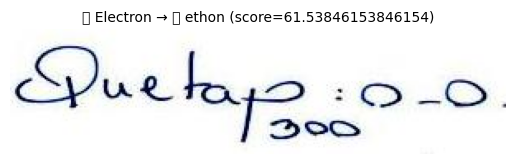

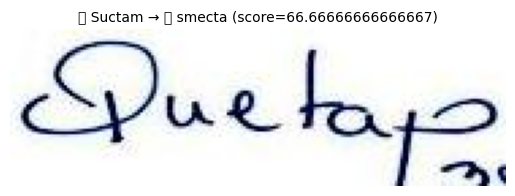

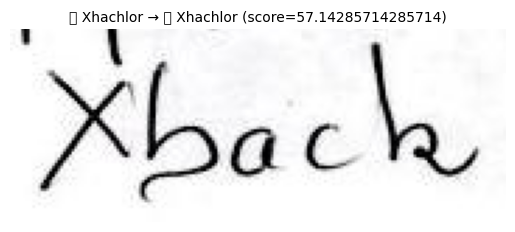

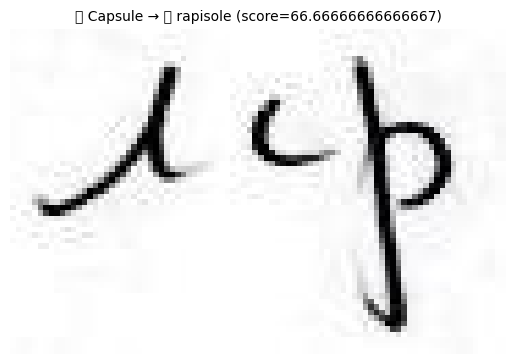

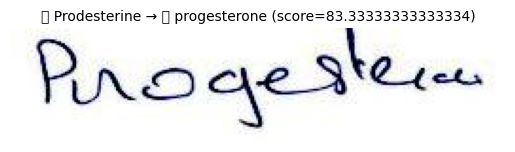

...

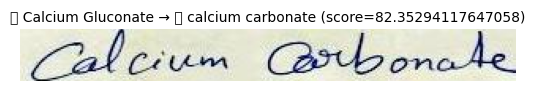

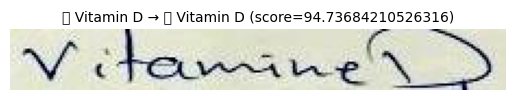

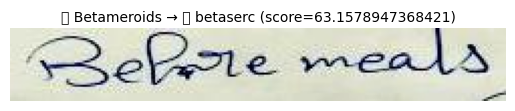

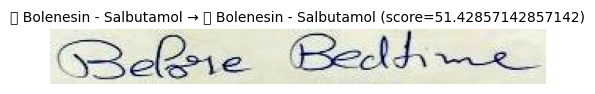

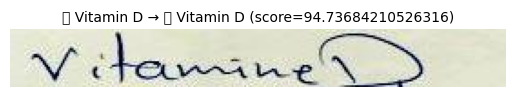

✅ Fichier CSV enregistré : /content/predictions.csv


In [10]:
# 🔁 Monter Google Drive
from google.colab import drive
drive.mount('/content/drive')

# 📦 Décompression du modèle fine-tuné
import zipfile
zip_path = "/content/drive/MyDrive/trocr_finetuned.zip"
extract_path = "/content/trocr_finetuned"
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall(extract_path)

# 🔍 Charger TrOCR fine-tuné
from transformers import VisionEncoderDecoderModel, TrOCRProcessor
model = VisionEncoderDecoderModel.from_pretrained(extract_path)
processor = TrOCRProcessor.from_pretrained(extract_path)
model.eval()

# 📁 Décompresser les images test
import os
test_dir = "/content/crops_test"

def check_zip_exists(zip_path):
    if not os.path.exists(zip_path):
        raise FileNotFoundError(f"Le fichier {zip_path} n'existe pas.")
    return True

def extract_zip(zip_path, extract_to):
    print(f"Décompression de {zip_path} vers {extract_to}...")
    os.makedirs(extract_to, exist_ok=True)
    with zipfile.ZipFile(zip_path, 'r') as zip_ref:
        zip_ref.extractall(extract_to)
    print("Décompression terminée.")

check_zip_exists('crops_test.zip')
extract_zip('crops_test.zip', test_dir)

# 📤 Générer dictionnaire depuis fichier CSV
import pandas as pd

csv_path = "/content/fichier_fine_tuning_final(in) (3).csv"
df = pd.read_csv(csv_path)

if "text" not in df.columns:
    raise ValueError("❌ La colonne 'text' est introuvable. Colonnes disponibles : " + str(df.columns.tolist()))

texts = df["text"].dropna().astype(str).str.strip().unique().tolist()
output_txt_path = "/content/texts_from_csv.txt"
with open(output_txt_path, "w", encoding="utf-8") as f:
    for line in texts:
        f.write(line + "\n")
print(f"✅ {len(texts)} lignes extraites et enregistrées dans : {output_txt_path}")

with open(output_txt_path, "r", encoding="utf-8") as f:
    med_dict = [line.strip().lower() for line in f if line.strip()]
print(f"✅ {len(med_dict)} termes médicaux chargés dans le dictionnaire.")

# 🔧 Matching amélioré avec nettoyage et rapidfuzz
!pip install rapidfuzz
from rapidfuzz import process, fuzz
import re

def clean_text(text):
    text = text.lower()
    text = re.sub(r"[^a-z0-9àâçéèêëîïôûùüÿñæœ\s\-]", "", text)
    text = re.sub(r"\s+", " ", text).strip()
    return text

def corriger_prediction(pred, dictionnaire):
    pred_clean = clean_text(pred)
    match, score, _ = process.extractOne(pred_clean, dictionnaire, scorer=fuzz.token_sort_ratio)

    # Si le score est trop faible, on garde la prédiction originale
    if score < 60:
        return pred.strip(), score

    # Si la prédiction nettoyée est très proche du match, on la garde
    if fuzz.token_sort_ratio(pred_clean, match) >= 90:
        return pred.strip(), score

    # Sinon, on corrige
    return match, score


# 🖼️ OCR sur images
from PIL import Image
import torch
import matplotlib.pyplot as plt

device = "cuda" if torch.cuda.is_available() else "cpu"
model.to(device)

image_paths = sorted([
    os.path.join(test_dir, fname)
    for fname in os.listdir(test_dir)
    if fname.lower().endswith((".jpg", ".png", ".jpeg"))
])

results = []

for path in image_paths:
    image = Image.open(path).convert("RGB")
    pixel_values = processor(images=image, return_tensors="pt").pixel_values.to(device)

    with torch.no_grad():
        generated_ids = model.generate(pixel_values)
    pred_text = processor.batch_decode(generated_ids, skip_special_tokens=True)[0]

    pred_corrige, score = corriger_prediction(pred_text, med_dict)

    results.append({
        "image_path": path,
        "ocr_pred": pred_text,
        "corrected_pred": pred_corrige,
        "similarity_score": score
    })

    # Affichage rapide
    plt.imshow(image)
    plt.axis("off")
    plt.title(f"📝 {pred_text} → ✅ {pred_corrige} (score={score})", fontsize=10)
    plt.show()

# 💾 Export CSV final
df_results = pd.DataFrame(results)
df_results.to_csv("/content/predictions.csv", index=False)
print("✅ Fichier CSV enregistré : /content/predictions.csv")